In [45]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score,confusion_matrix, classification_report
from joblib import dump
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from joblib import load
from sklearn.preprocessing import StandardScaler

In [2]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [3]:
from google.colab import files
import io
uploaded = files.upload()

Saving WA_Fn-UseC_-HR-Employee-Attrition.csv to WA_Fn-UseC_-HR-Employee-Attrition.csv


In [4]:
df = pd.read_csv('WA_Fn-UseC_-HR-Employee-Attrition.csv')

In [5]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2


In [ ]:
df.tail()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,3,Male,41,4,2,Laboratory Technician,4,Married,2571,12290,4,Y,No,17,3,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,4,Male,42,2,3,Healthcare Representative,1,Married,9991,21457,4,Y,No,15,3,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,2,Male,87,4,2,Manufacturing Director,2,Married,6142,5174,1,Y,Yes,20,4,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,4,Male,63,2,2,Sales Executive,2,Married,5390,13243,2,Y,No,14,3,4,80,0,17,3,2,9,6,0,8
1469,34,No,Travel_Rarely,628,Research & Development,8,3,Medical,1,2068,2,Male,82,4,2,Laboratory Technician,3,Married,4404,10228,2,Y,No,12,3,1,80,0,6,3,4,4,3,1,2


In [ ]:
df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

In [ ]:
df.isna().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [6]:
duplicates = df.duplicated()
duplicates.sum()

0

In [7]:
cat_data=[]
num_data=[]
for i,c in enumerate(df.dtypes):
    if c==object:
        cat_data.append(df.iloc[:,i])
    else:
        num_data.append(df.iloc[:,i])
cat_data =pd.DataFrame(cat_data).transpose()
cat_data

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
0,Yes,Travel_Rarely,Sales,Life Sciences,Female,Sales Executive,Single,Y,Yes
1,No,Travel_Frequently,Research & Development,Life Sciences,Male,Research Scientist,Married,Y,No
2,Yes,Travel_Rarely,Research & Development,Other,Male,Laboratory Technician,Single,Y,Yes
3,No,Travel_Frequently,Research & Development,Life Sciences,Female,Research Scientist,Married,Y,Yes
4,No,Travel_Rarely,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No
5,No,Travel_Frequently,Research & Development,Life Sciences,Male,Laboratory Technician,Single,Y,No
6,No,Travel_Rarely,Research & Development,Medical,Female,Laboratory Technician,Married,Y,Yes
7,No,Travel_Rarely,Research & Development,Life Sciences,Male,Laboratory Technician,Divorced,Y,No
8,No,Travel_Frequently,Research & Development,Life Sciences,Male,Manufacturing Director,Single,Y,No
9,No,Travel_Rarely,Research & Development,Medical,Male,Healthcare Representative,Married,Y,No


Attrition
No     1233
Yes     237
Name: count, dtype: int64


<ipython-input-8-8d16beab8409>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attrition_counts.index, y=attrition_counts.values, palette='viridis')


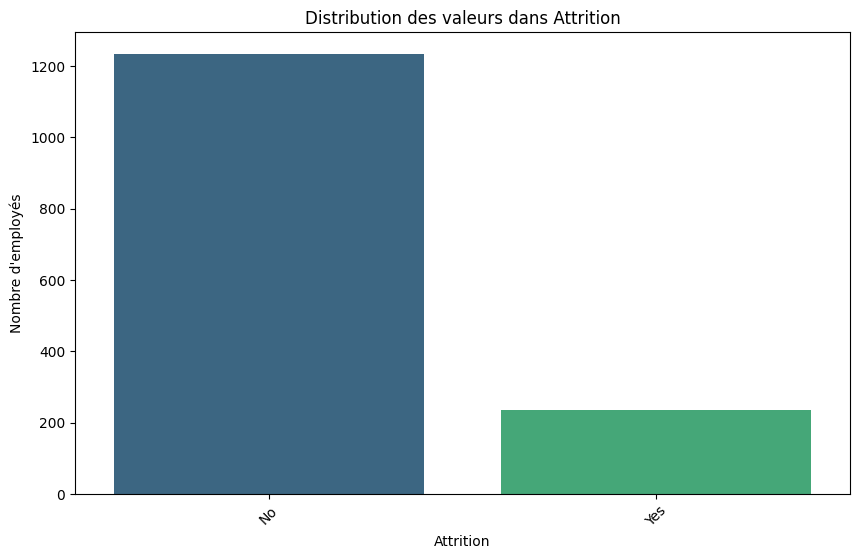

In [8]:
attrition_counts = df['Attrition'].value_counts()

# Afficher les valeurs uniques et leurs comptes
print(attrition_counts)

# Tracer un graphique en barres
plt.figure(figsize=(10, 6))
sns.barplot(x=attrition_counts.index, y=attrition_counts.values, palette='viridis')
plt.title('Distribution des valeurs dans Attrition')
plt.xlabel('Attrition')
plt.ylabel('Nombre d\'employés')
plt.xticks(rotation=45)
plt.show()

BusinessTravel
Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: count, dtype: int64


<ipython-input-42-8f763b58fcd2>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=busnissTravel_counts.index, y=busnissTravel_counts.values, palette='viridis')


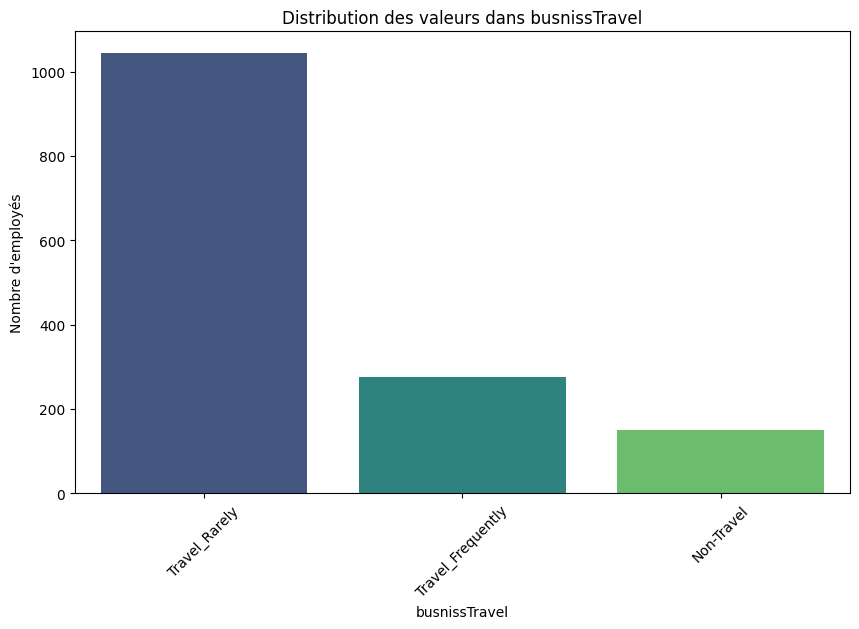

In [ ]:
busnissTravel_counts = df['BusinessTravel'].value_counts()

# Afficher les valeurs uniques et leurs comptes
print(busnissTravel_counts)

# Tracer un graphique en barres
plt.figure(figsize=(10, 6))
sns.barplot(x=busnissTravel_counts.index, y=busnissTravel_counts.values, palette='viridis')
plt.title('Distribution des valeurs dans busnissTravel')
plt.xlabel('busnissTravel')
plt.ylabel('Nombre d\'employés')
plt.xticks(rotation=45)
plt.show()

Gender
Male      882
Female    588
Name: count, dtype: int64


<ipython-input-43-c7e43e5c6bcd>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=gender_counts.index, y=gender_counts.values, palette='viridis')


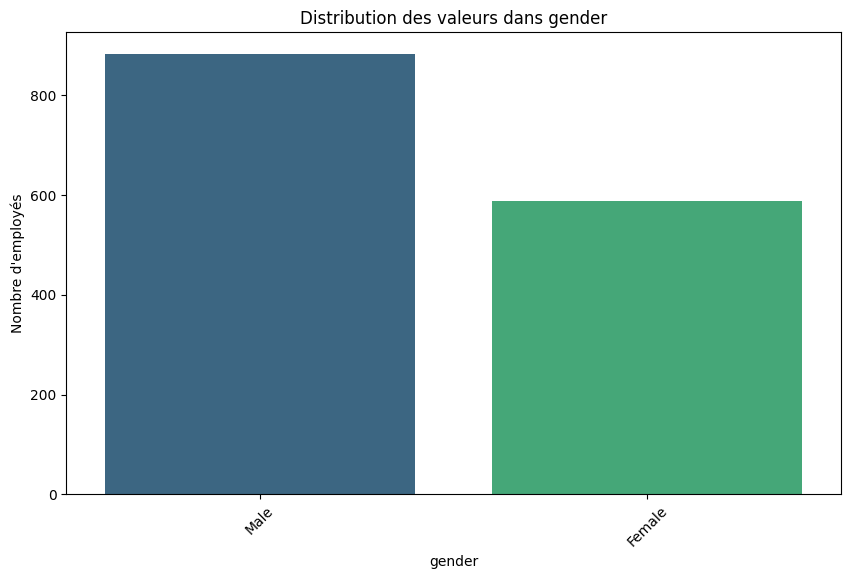

In [ ]:
gender_counts = df['Gender'].value_counts()

# Afficher les valeurs uniques et leurs comptes
print(gender_counts)

# Tracer un graphique en barres
plt.figure(figsize=(10, 6))
sns.barplot(x=gender_counts.index, y=gender_counts.values, palette='viridis')
plt.title('Distribution des valeurs dans gender')
plt.xlabel('gender')
plt.ylabel('Nombre d\'employés')
plt.xticks(rotation=45)
plt.show()

MaritalStatus
Married     673
Single      470
Divorced    327
Name: count, dtype: int64


<ipython-input-45-67909d99c57f>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=maritalStatus_counts.index, y=maritalStatus_counts.values, palette='viridis')


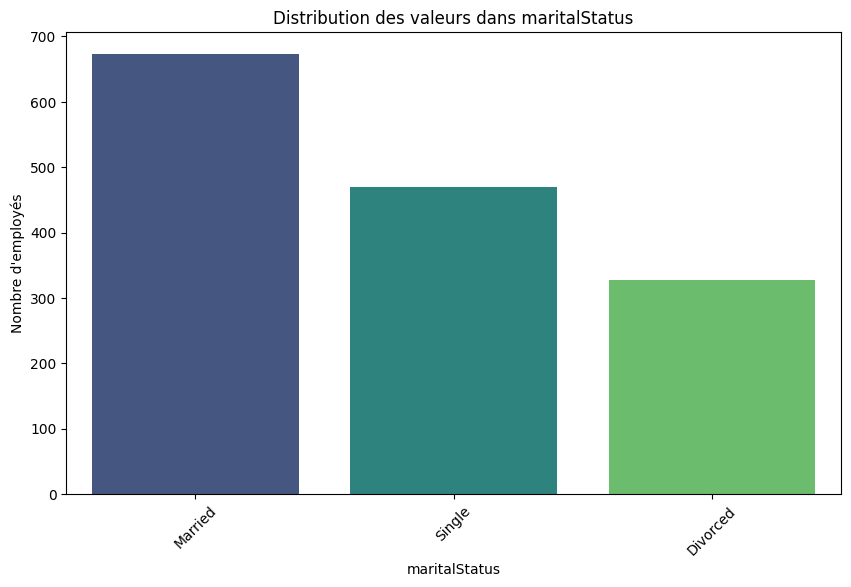

In [ ]:
maritalStatus_counts = df['MaritalStatus'].value_counts()

# Afficher les valeurs uniques et leurs comptes
print(maritalStatus_counts)

# Tracer un graphique en barres
plt.figure(figsize=(10, 6))
sns.barplot(x=maritalStatus_counts.index, y=maritalStatus_counts.values, palette='viridis')
plt.title('Distribution des valeurs dans maritalStatus')
plt.xlabel('maritalStatus')
plt.ylabel('Nombre d\'employés')
plt.xticks(rotation=45)
plt.show()

OverTime
No     1054
Yes     416
Name: count, dtype: int64


<ipython-input-47-bdd0818f3610>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=overTime_counts.index, y=overTime_counts.values, palette='viridis')


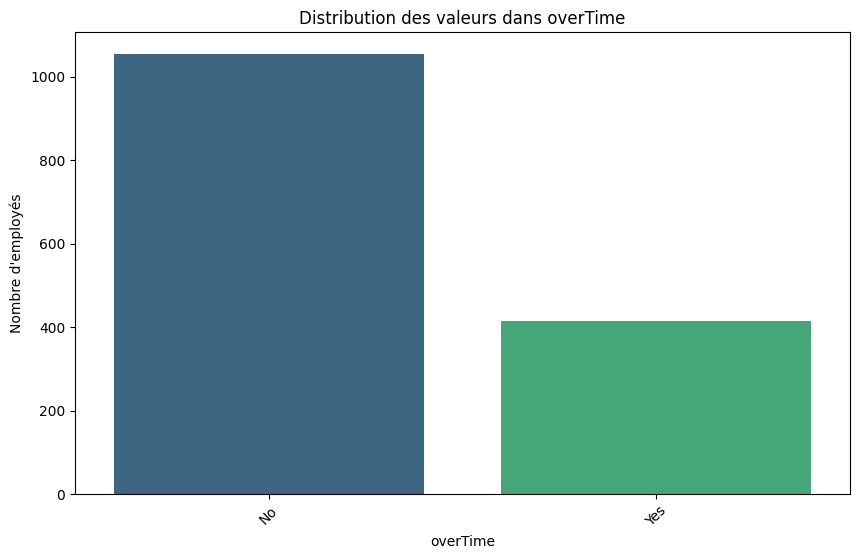

In [ ]:
overTime_counts = df['OverTime'].value_counts()

# Afficher les valeurs uniques et leurs comptes
print(overTime_counts)

# Tracer un graphique en barres
plt.figure(figsize=(10, 6))
sns.barplot(x=overTime_counts.index, y=overTime_counts.values, palette='viridis')
plt.title('Distribution des valeurs dans overTime')
plt.xlabel('overTime')
plt.ylabel('Nombre d\'employés')
plt.xticks(rotation=45)
plt.show()

In [ ]:
df.EducationField.unique()

array(['Life Sciences', 'Other', 'Medical', 'Marketing',
       'Technical Degree', 'Human Resources'], dtype=object)

EducationField
Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: count, dtype: int64


<ipython-input-31-86e6ca86bcd6>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=education_counts.index, y=education_counts.values, palette='viridis')


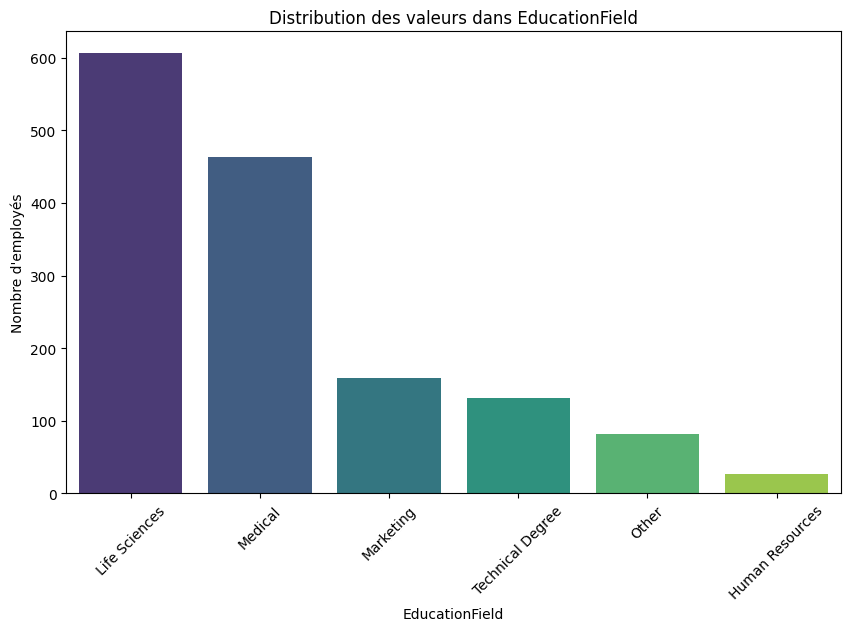

In [ ]:
education_counts = df['EducationField'].value_counts()

# Afficher les valeurs uniques et leurs comptes
print(education_counts)

# Tracer un graphique en barres
plt.figure(figsize=(10, 6))
sns.barplot(x=education_counts.index, y=education_counts.values, palette='viridis')
plt.title('Distribution des valeurs dans EducationField')
plt.xlabel('EducationField')
plt.ylabel('Nombre d\'employés')
plt.xticks(rotation=45)
plt.show()

JobRole
Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: count, dtype: int64


<ipython-input-33-d6d73b42c021>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=job_counts.index, y=job_counts.values, palette='viridis')


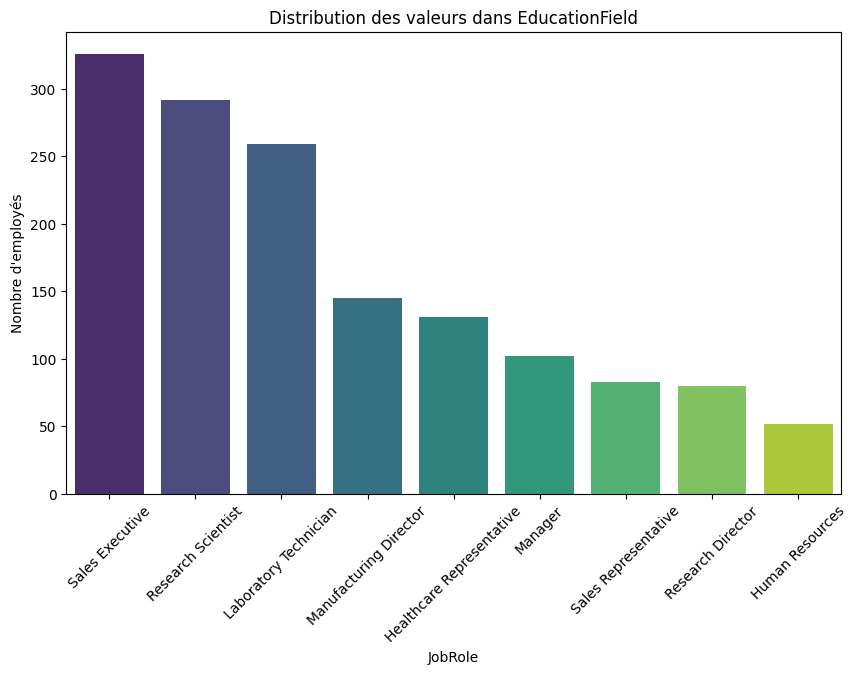

In [ ]:
job_counts = df['JobRole'].value_counts()

# Afficher les valeurs uniques et leurs comptes
print(job_counts)

# Tracer un graphique en barres
plt.figure(figsize=(10, 6))
sns.barplot(x=job_counts.index, y=job_counts.values, palette='viridis')
plt.title('Distribution des valeurs dans EducationField')
plt.xlabel('JobRole')
plt.ylabel('Nombre d\'employés')
plt.xticks(rotation=45)
plt.show()

In [9]:
num_data =pd.DataFrame(num_data).transpose()
num_data

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,1,1,2,94,3,2,4,5993,19479,8,11,3,1,80,0,8,0,1,6,4,0,5
1,49,279,8,1,1,2,3,61,2,2,2,5130,24907,1,23,4,4,80,1,10,3,3,10,7,1,7
2,37,1373,2,2,1,4,4,92,2,1,3,2090,2396,6,15,3,2,80,0,7,3,3,0,0,0,0
3,33,1392,3,4,1,5,4,56,3,1,3,2909,23159,1,11,3,3,80,0,8,3,3,8,7,3,0
4,27,591,2,1,1,7,1,40,3,1,2,3468,16632,9,12,3,4,80,1,6,3,3,2,2,2,2
5,32,1005,2,2,1,8,4,79,3,1,4,3068,11864,0,13,3,3,80,0,8,2,2,7,7,3,6
6,59,1324,3,3,1,10,3,81,4,1,1,2670,9964,4,20,4,1,80,3,12,3,2,1,0,0,0
7,30,1358,24,1,1,11,4,67,3,1,3,2693,13335,1,22,4,2,80,1,1,2,3,1,0,0,0
8,38,216,23,3,1,12,4,44,2,3,3,9526,8787,0,21,4,2,80,0,10,2,3,9,7,1,8
9,36,1299,27,3,1,13,3,94,3,2,3,5237,16577,6,13,3,2,80,2,17,3,2,7,7,7,7


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [ ]:
df.shape

(1470, 35)

In [ ]:
df.shape[0]


1470

In [ ]:
df.shape[1]

35

In [ ]:
df.dtypes.value_counts()

int64     26
object     9
Name: count, dtype: int64

In [ ]:
df.select_dtypes(['object']).head()

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
0,Yes,Travel_Rarely,Sales,Life Sciences,Female,Sales Executive,Single,Y,Yes
1,No,Travel_Frequently,Research & Development,Life Sciences,Male,Research Scientist,Married,Y,No
2,Yes,Travel_Rarely,Research & Development,Other,Male,Laboratory Technician,Single,Y,Yes
3,No,Travel_Frequently,Research & Development,Life Sciences,Female,Research Scientist,Married,Y,Yes
4,No,Travel_Rarely,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No


In [ ]:
df.select_dtypes(['int64']).head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,1,1,2,94,3,2,4,5993,19479,8,11,3,1,80,0,8,0,1,6,4,0,5
1,49,279,8,1,1,2,3,61,2,2,2,5130,24907,1,23,4,4,80,1,10,3,3,10,7,1,7
2,37,1373,2,2,1,4,4,92,2,1,3,2090,2396,6,15,3,2,80,0,7,3,3,0,0,0,0
3,33,1392,3,4,1,5,4,56,3,1,3,2909,23159,1,11,3,3,80,0,8,3,3,8,7,3,0
4,27,591,2,1,1,7,1,40,3,1,2,3468,16632,9,12,3,4,80,1,6,3,3,2,2,2,2


In [ ]:
unique_count = df['EmployeeNumber'].nunique()
total_count = len(df)

if unique_count == total_count:
    print("Toutes les valeurs dans la colonne EmployeeNumber sont uniques.")
else:
    print(f"Il y a {unique_count} valeurs uniques sur {total_count} dans la colonne EmployeeNumber.")


Toutes les valeurs dans la colonne EmployeeNumber sont uniques.


In [ ]:
df.describe()


,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,2.728571,6502.931293,14313.103401,2.693197,15.209524,3.153741,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,1.102846,4707.956783,7117.786044,2.498009,3.659938,0.360824,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,1.000000,1009.000000,2094.000000,0.000000,11.000000,3.000000,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,2.000000,2911.000000,8047.000000,1.000000,12.000000,3.000000,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,3.000000,4919.000000,14235.500000,2.000000,14.000000,3.000000,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,4.000000,8379.000000,20461.500000,4.000000,18.000000,3.000000,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,4.000000,19999.000000,26999.000000,9.000000,25.000000,4.000000,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [ ]:
df.describe(include='O')

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


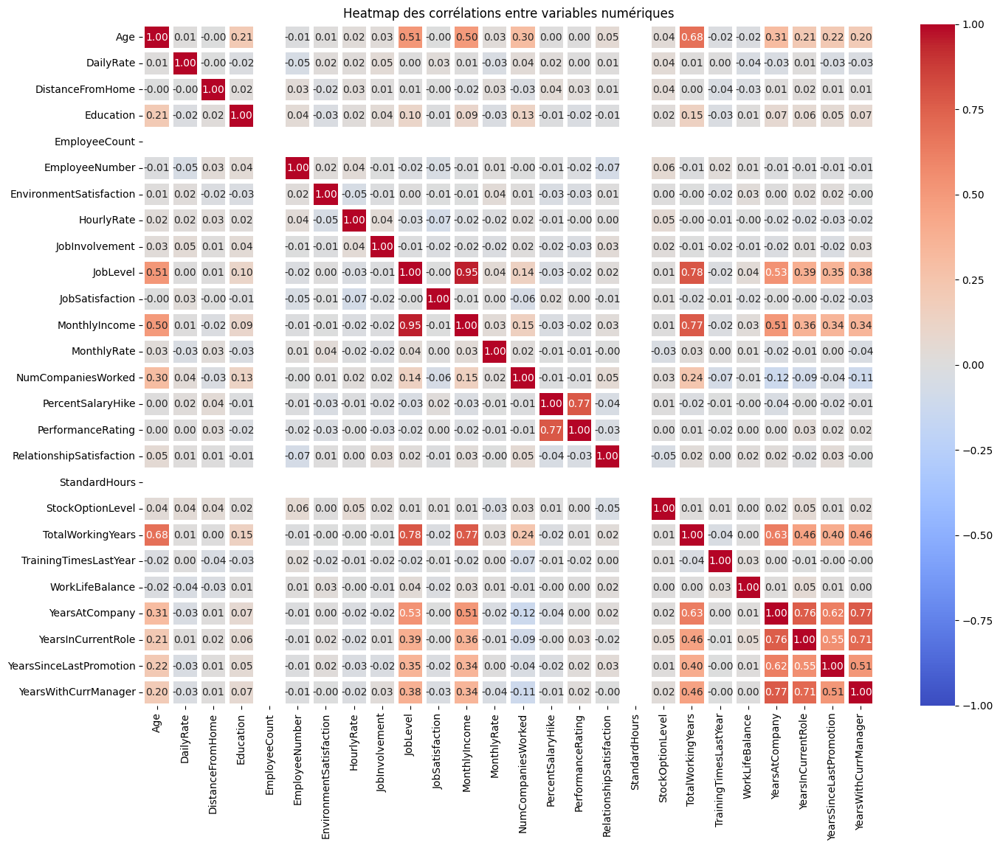

In [ ]:
# Sélectionner les colonnes numériques et calculer la matrice de corrélation
numeric_cols = df.select_dtypes(include='number')
correlation_matrix = numeric_cols.corr()

# Afficher la heatmap des corrélations
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm',lw=4,vmax=1,vmin=-1, fmt=".2f")
plt.title('Heatmap des corrélations entre variables numériques')
plt.show()

**data cleaning**

In [13]:
cat_data.drop('Over18',axis=1,inplace=True)


,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,2,3,2,4,5993,19479,8,11,3,1,80,0,8,0,1,6,4,0,5
1,49,279,8,1,3,2,2,2,5130,24907,1,23,4,4,80,1,10,3,3,10,7,1,7
2,37,1373,2,2,4,2,1,3,2090,2396,6,15,3,2,80,0,7,3,3,0,0,0,0
3,33,1392,3,4,4,3,1,3,2909,23159,1,11,3,3,80,0,8,3,3,8,7,3,0
4,27,591,2,1,1,3,1,2,3468,16632,9,12,3,4,80,1,6,3,3,2,2,2,2
5,32,1005,2,2,4,3,1,4,3068,11864,0,13,3,3,80,0,8,2,2,7,7,3,6
6,59,1324,3,3,3,4,1,1,2670,9964,4,20,4,1,80,3,12,3,2,1,0,0,0
7,30,1358,24,1,4,3,1,3,2693,13335,1,22,4,2,80,1,1,2,3,1,0,0,0
8,38,216,23,3,4,2,3,3,9526,8787,0,21,4,2,80,0,10,2,3,9,7,1,8
9,36,1299,27,3,3,3,2,3,5237,16577,6,13,3,2,80,2,17,3,2,7,7,7,7


In [10]:
num_data.drop('EmployeeCount',axis=1,inplace=True)
num_data

,Age,DailyRate,DistanceFromHome,Education,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,1,2,94,3,2,4,5993,19479,8,11,3,1,80,0,8,0,1,6,4,0,5
1,49,279,8,1,2,3,61,2,2,2,5130,24907,1,23,4,4,80,1,10,3,3,10,7,1,7
2,37,1373,2,2,4,4,92,2,1,3,2090,2396,6,15,3,2,80,0,7,3,3,0,0,0,0
3,33,1392,3,4,5,4,56,3,1,3,2909,23159,1,11,3,3,80,0,8,3,3,8,7,3,0
4,27,591,2,1,7,1,40,3,1,2,3468,16632,9,12,3,4,80,1,6,3,3,2,2,2,2
5,32,1005,2,2,8,4,79,3,1,4,3068,11864,0,13,3,3,80,0,8,2,2,7,7,3,6
6,59,1324,3,3,10,3,81,4,1,1,2670,9964,4,20,4,1,80,3,12,3,2,1,0,0,0
7,30,1358,24,1,11,4,67,3,1,3,2693,13335,1,22,4,2,80,1,1,2,3,1,0,0,0
8,38,216,23,3,12,4,44,2,3,3,9526,8787,0,21,4,2,80,0,10,2,3,9,7,1,8
9,36,1299,27,3,13,3,94,3,2,3,5237,16577,6,13,3,2,80,2,17,3,2,7,7,7,7


In [11]:
num_data.drop('EmployeeNumber',axis=1,inplace=True)
num_data

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,2,94,3,2,4,5993,19479,8,11,3,1,80,0,8,0,1,6,4,0,5
1,49,279,8,1,3,61,2,2,2,5130,24907,1,23,4,4,80,1,10,3,3,10,7,1,7
2,37,1373,2,2,4,92,2,1,3,2090,2396,6,15,3,2,80,0,7,3,3,0,0,0,0
3,33,1392,3,4,4,56,3,1,3,2909,23159,1,11,3,3,80,0,8,3,3,8,7,3,0
4,27,591,2,1,1,40,3,1,2,3468,16632,9,12,3,4,80,1,6,3,3,2,2,2,2
5,32,1005,2,2,4,79,3,1,4,3068,11864,0,13,3,3,80,0,8,2,2,7,7,3,6
6,59,1324,3,3,3,81,4,1,1,2670,9964,4,20,4,1,80,3,12,3,2,1,0,0,0
7,30,1358,24,1,4,67,3,1,3,2693,13335,1,22,4,2,80,1,1,2,3,1,0,0,0
8,38,216,23,3,4,44,2,3,3,9526,8787,0,21,4,2,80,0,10,2,3,9,7,1,8
9,36,1299,27,3,3,94,3,2,3,5237,16577,6,13,3,2,80,2,17,3,2,7,7,7,7


In [12]:
num_data.drop('HourlyRate',axis=1,inplace=True)
num_data

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,2,3,2,4,5993,19479,8,11,3,1,80,0,8,0,1,6,4,0,5
1,49,279,8,1,3,2,2,2,5130,24907,1,23,4,4,80,1,10,3,3,10,7,1,7
2,37,1373,2,2,4,2,1,3,2090,2396,6,15,3,2,80,0,7,3,3,0,0,0,0
3,33,1392,3,4,4,3,1,3,2909,23159,1,11,3,3,80,0,8,3,3,8,7,3,0
4,27,591,2,1,1,3,1,2,3468,16632,9,12,3,4,80,1,6,3,3,2,2,2,2
5,32,1005,2,2,4,3,1,4,3068,11864,0,13,3,3,80,0,8,2,2,7,7,3,6
6,59,1324,3,3,3,4,1,1,2670,9964,4,20,4,1,80,3,12,3,2,1,0,0,0
7,30,1358,24,1,4,3,1,3,2693,13335,1,22,4,2,80,1,1,2,3,1,0,0,0
8,38,216,23,3,4,2,3,3,9526,8787,0,21,4,2,80,0,10,2,3,9,7,1,8
9,36,1299,27,3,3,3,2,3,5237,16577,6,13,3,2,80,2,17,3,2,7,7,7,7


<ipython-input-42-47ff8cfbea76>:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[column], kde=False, bins=20, palette='viridis')
<ipython-input-42-47ff8cfbea76>:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[column], kde=False, bins=20, palette='viridis')
<ipython-input-42-47ff8cfbea76>:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[column], kde=False, bins=20, palette='viridis')
<ipython-input-42-47ff8cfbea76>:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[column], kde=False, bins=20, palette='viridis')
<ipython-input-42-47ff8cfbea76>:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[column], kde=False, bins=20, palette='viridis')
<ipython-input-42-47ff8cfbea76>:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned

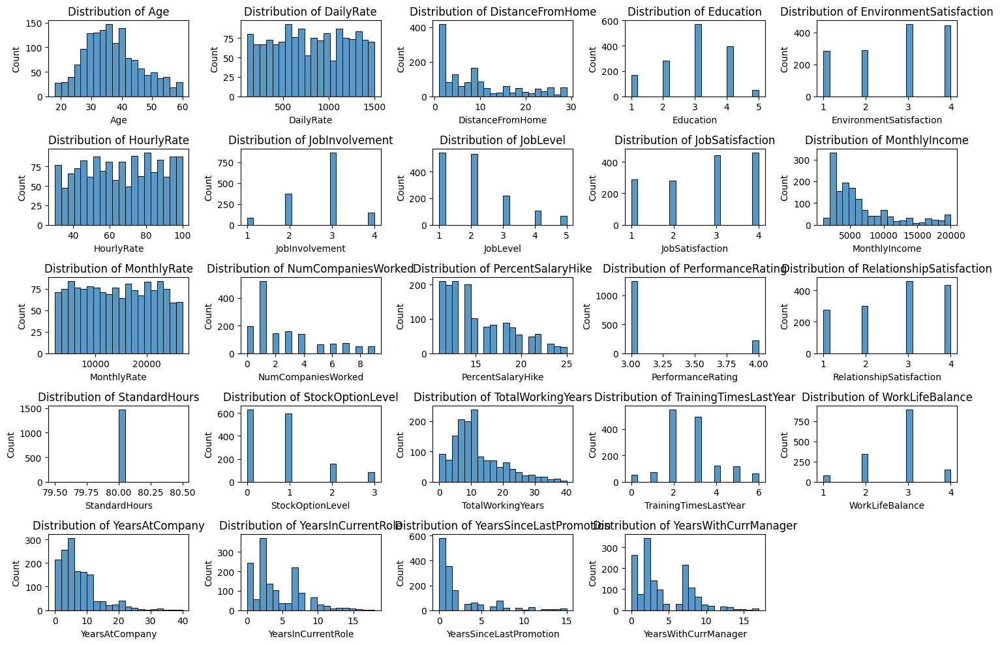

In [ ]:
plt.figure(figsize=(15, 10))
for i, column in enumerate(num_data, 1):
    plt.subplot(5, 5, i)
    sns.histplot(df[column], kde=False, bins=20, palette='viridis')
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Count')
plt.tight_layout()
plt.show()

**data Encoding**

In [14]:
Attrition_Value={'Yes':1,'No':0}
Attrition=cat_data['Attrition']
cat_data.drop('Attrition',axis=1,inplace=True)
Attrition=Attrition.map(Attrition_Value)
Attrition


0       1
1       0
2       1
3       0
4       0
5       0
6       0
7       0
8       0
9       0
10      0
11      0
12      0
13      0
14      1
15      0
16      0
17      0
18      0
19      0
20      0
21      1
22      0
23      0
24      1
25      0
26      1
27      0
28      0
29      0
30      0
31      0
32      0
33      1
34      1
35      0
36      1
37      0
38      0
39      0
40      0
41      0
42      1
43      0
44      0
45      1
46      0
47      0
48      0
49      0
50      1
51      1
52      0
53      0
54      0
55      0
56      0
57      0
58      0
59      0
60      0
61      0
62      0
63      0
64      0
65      0
66      0
67      0
68      0
69      1
70      0
71      0
72      0
73      0
74      0
75      0
76      0
77      0
78      0
79      0
80      0
81      0
82      0
83      0
84      0
85      0
86      0
87      0
88      0
89      1
90      0
91      0
92      0
93      0
94      0
95      0
96      0
97      0
98      0
99      0


In [27]:
cat_data.columns

Index(['BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole',
       'MaritalStatus', 'OverTime'],
      dtype='object')

In [39]:
nominal_columns = ['EducationField', 'JobRole','MaritalStatus', 'Department']
ordinal_columns = ['BusinessTravel', 'Gender', 'OverTime']


cat_data_ordinal =df[ordinal_columns]
cat_data_nominal =df[nominal_columns]

cat_data_ordinal


,BusinessTravel,Gender,OverTime
0,Travel_Rarely,Female,Yes
1,Travel_Frequently,Male,No
2,Travel_Rarely,Male,Yes
3,Travel_Frequently,Female,Yes
4,Travel_Rarely,Male,No
5,Travel_Frequently,Male,No
6,Travel_Rarely,Female,Yes
7,Travel_Rarely,Male,No
8,Travel_Frequently,Male,No
9,Travel_Rarely,Male,No


In [40]:
label_encoders = {}
for col in ordinal_columns:
    le = LabelEncoder()
    cat_data_ordinal[col] = le.fit_transform(cat_data_ordinal[col])
    label_encoders[col] = le

# Encodage des variables nominales avec One-Hot Encoding
cat_data_nominal_encoded = pd.get_dummies(cat_data_nominal)
cat_data_nominal_encoded



<ipython-input-40-e06059731334>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cat_data_ordinal[col] = le.fit_transform(cat_data_ordinal[col])
<ipython-input-40-e06059731334>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cat_data_ordinal[col] = le.fit_transform(cat_data_ordinal[col])
<ipython-input-40-e06059731334>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Department_Human Resources,Department_Research & Development,Department_Sales
0,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,True
1,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,True,False
2,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,True,False,True,False
3,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,True,False
4,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,True,False
5,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,True,False
6,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,True,False
7,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,True,False
8,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,True,False
9,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True,False


In [42]:
# Convert any boolean columns to integers
cat_data_nominal_encoded = cat_data_nominal_encoded.astype(int)
cat_data_nominal_encoded

,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Department_Human Resources,Department_Research & Development,Department_Sales
0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1
1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0
2,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0
3,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0
4,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0
5,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0
6,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0
7,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0
8,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0
9,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0


In [41]:
cat_data_ordinal

,BusinessTravel,Gender,OverTime
0,2,0,1
1,1,1,0
2,2,1,1
3,1,0,1
4,2,1,0
5,1,1,0
6,2,0,1
7,2,1,0
8,1,1,0
9,2,1,0


In [15]:
le=LabelEncoder()
for i in cat_data:
  cat_data[i]=le.fit_transform(cat_data[i])
cat_data

,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,OverTime
0,2,2,1,0,7,2,1
1,1,1,1,1,6,1,0
2,2,1,4,1,2,2,1
3,1,1,1,0,6,1,1
4,2,1,3,1,2,1,0
5,1,1,1,1,2,2,0
6,2,1,3,0,2,1,1
7,2,1,1,1,2,0,0
8,1,1,1,1,4,2,0
9,2,1,3,1,0,1,0


**check outliers**

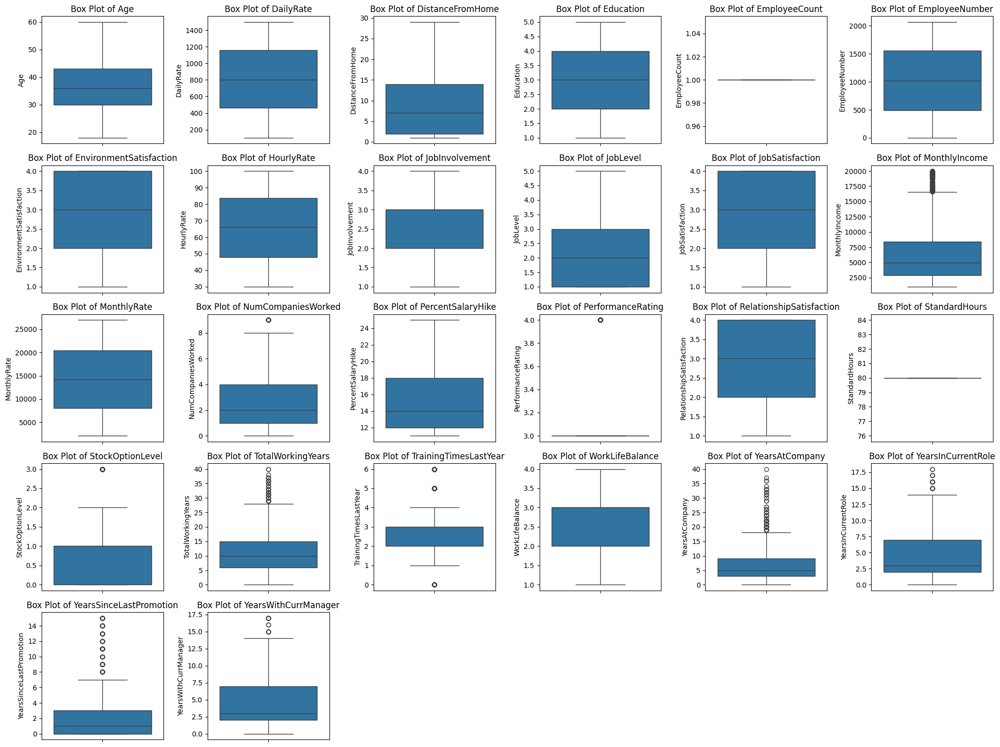

In [ ]:
plt.figure(figsize=(20, 15))
for i, column in enumerate(num_data):
    plt.subplot(5, 6, i+1)
    sns.boxplot(y=df[column])
    plt.title(f'Box Plot of {column}')
plt.tight_layout()
plt.show()

**data exploration with encoding**

In [ ]:
num_data.columns

Index(['Age', 'DailyRate', 'DistanceFromHome', 'Education',
       'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel',
       'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StandardHours', 'StockOptionLevel', 'TotalWorkingYears',
       'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany',
       'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [ ]:
cat_data.columns

Index(['BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole',
       'MaritalStatus', 'Over18', 'OverTime'],
      dtype='object')

In [16]:
data=pd.concat([cat_data,num_data,Attrition],axis=1)

In [83]:
dataHotEncoding=pd.concat([cat_data_nominal_encoded,cat_data_ordinal,num_data,Attrition],axis=1)

In [ ]:
data.columns

Index(['BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole',
       'MaritalStatus', 'Over18', 'OverTime', 'Age', 'DailyRate',
       'DistanceFromHome', 'Education', 'EnvironmentSatisfaction',
       'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StandardHours', 'StockOptionLevel', 'TotalWorkingYears',
       'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany',
       'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager',
       'Attrition'],
      dtype='object')

In [84]:
dataHotEncoding.columns

Index(['EducationField_Human Resources', 'EducationField_Life Sciences',
       'EducationField_Marketing', 'EducationField_Medical',
       'EducationField_Other', 'EducationField_Technical Degree',
       'JobRole_Healthcare Representative', 'JobRole_Human Resources',
       'JobRole_Laboratory Technician', 'JobRole_Manager',
       'JobRole_Manufacturing Director', 'JobRole_Research Director',
       'JobRole_Research Scientist', 'JobRole_Sales Executive',
       'JobRole_Sales Representative', 'MaritalStatus_Divorced',
       'MaritalStatus_Married', 'MaritalStatus_Single',
       'Department_Human Resources', 'Department_Research & Development',
       'Department_Sales', 'BusinessTravel', 'Gender', 'OverTime', 'Age',
       'DailyRate', 'DistanceFromHome', 'Education', 'EnvironmentSatisfaction',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfac

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/usr/

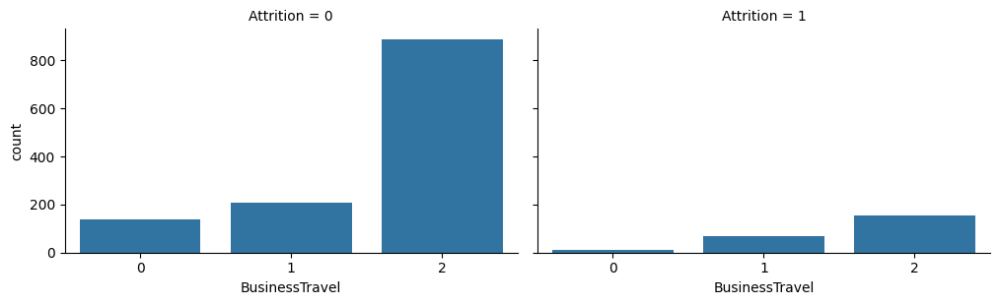

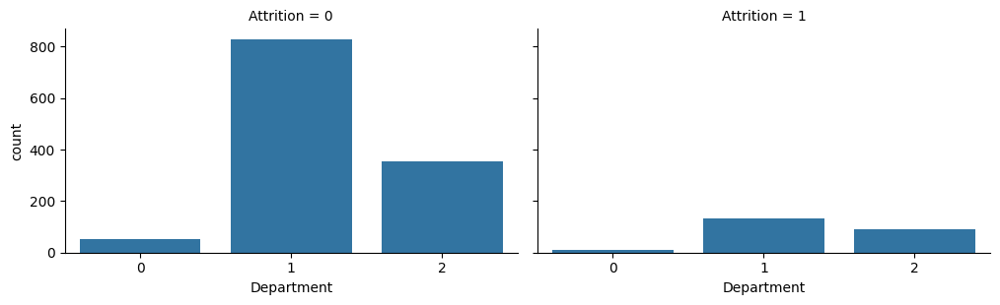

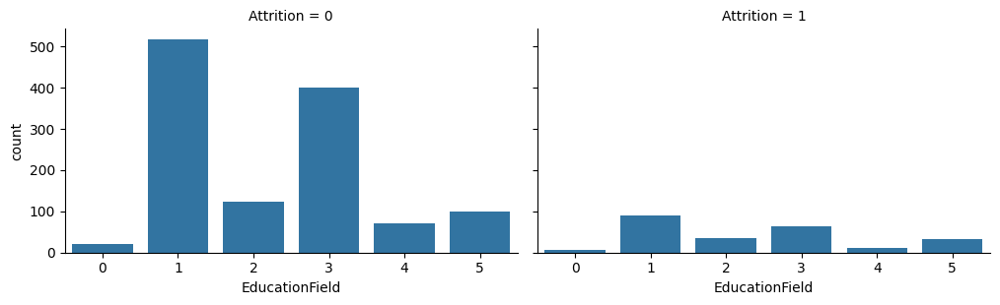

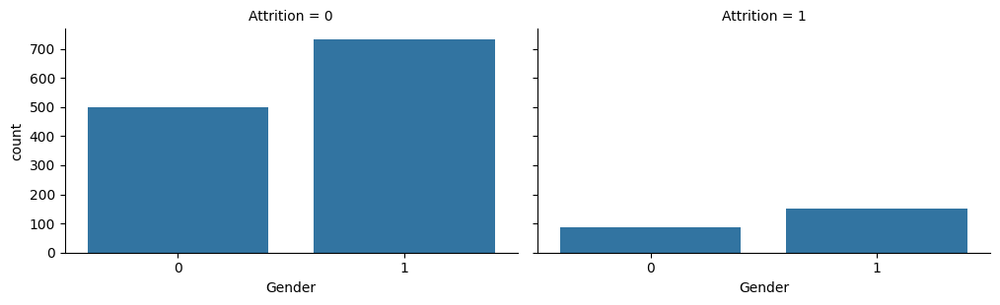

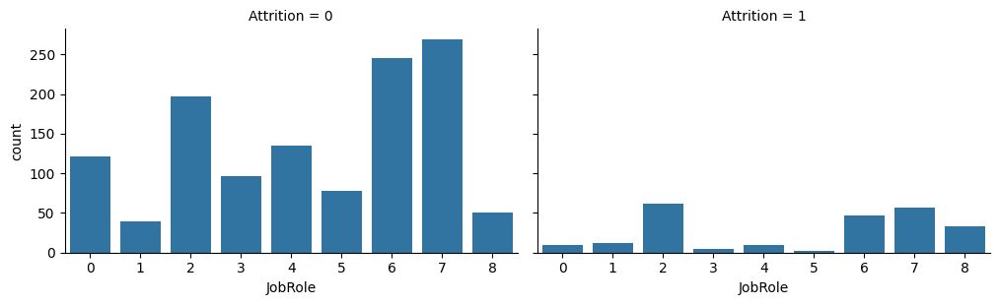

...

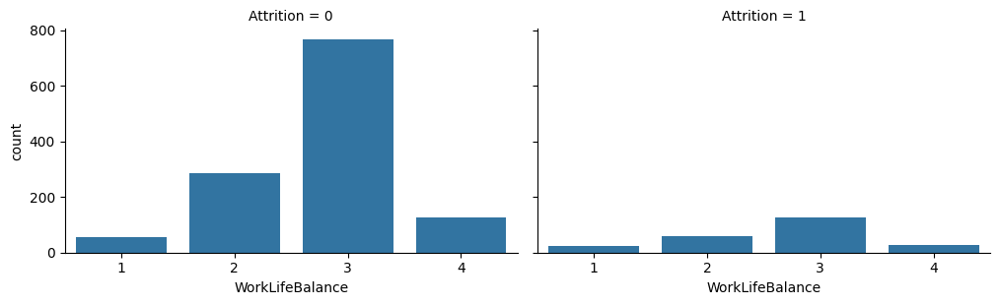

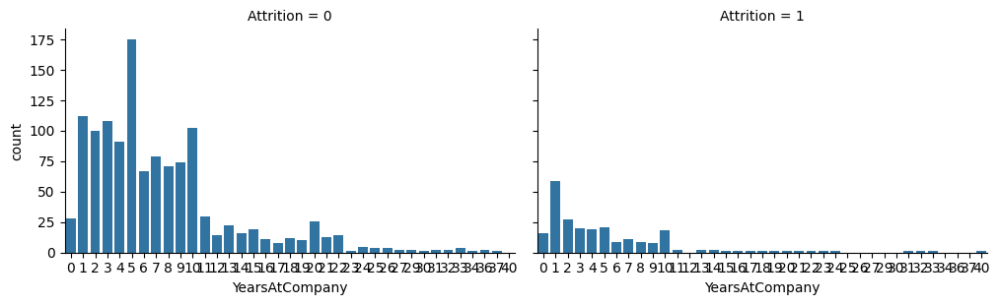

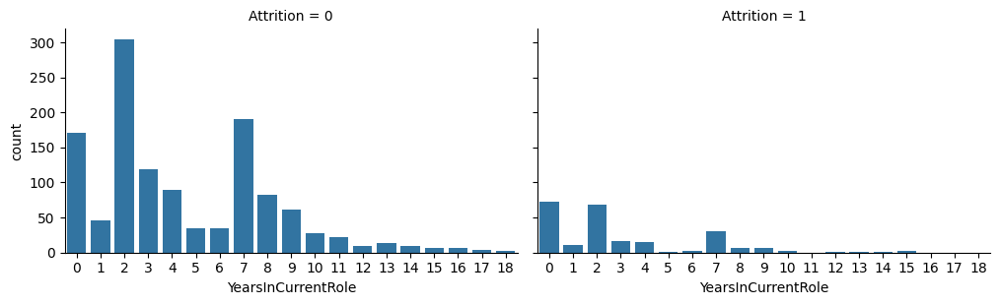

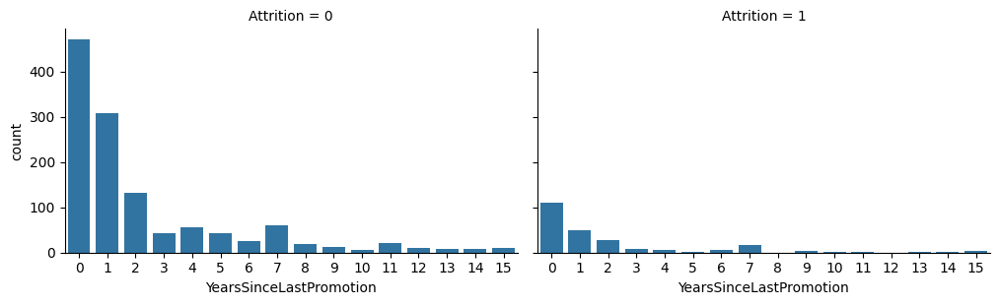

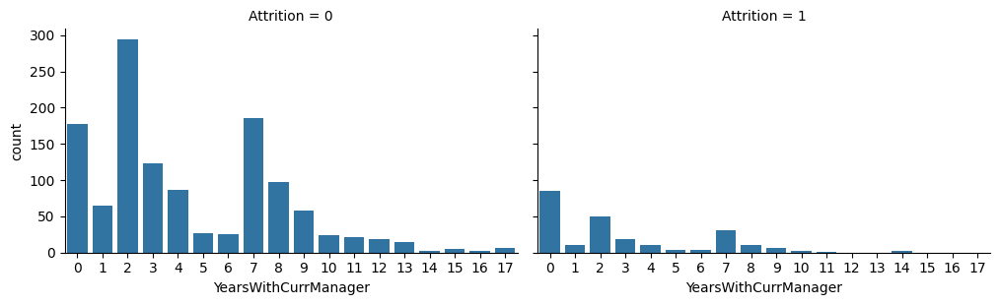

In [17]:

# Mapper un countplot pour chaque colonne spécifiée
for col in data.columns:
  if col != 'Attrition':
    grid = sns.FacetGrid(data, col='Attrition', height=3.2, aspect=1.6)
    grid.map(sns.countplot, col)

# Afficher la grille de facettes
plt.show()

In [18]:
data.groupby('Attrition').median()

,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,OverTime,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Attrition,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2.0,1.0,2.0,1.0,5.0,1.0,0.0,36.0,817.0,7.0,3.0,3.0,3.0,2.0,3.0,5204.0,14120.0,2.0,14.0,3.0,3.0,80.0,1.0,10.0,3.0,3.0,6.0,3.0,1.0,3.0
1,2.0,1.0,2.0,1.0,6.0,2.0,1.0,32.0,699.0,9.0,3.0,3.0,3.0,1.0,3.0,3202.0,14618.0,1.0,14.0,3.0,3.0,80.0,0.0,7.0,2.0,3.0,3.0,2.0,1.0,2.0


In [87]:
dataHotEncoding.groupby('Attrition').median()

,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Department_Human Resources,Department_Research & Development,Department_Sales,BusinessTravel,Gender,OverTime,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Attrition,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,1.0,0.0,36.0,817.0,7.0,3.0,3.0,3.0,2.0,3.0,5204.0,14120.0,2.0,14.0,3.0,3.0,80.0,1.0,10.0,3.0,3.0,6.0,3.0,1.0,3.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0,1.0,1.0,32.0,699.0,9.0,3.0,3.0,3.0,1.0,3.0,3202.0,14618.0,1.0,14.0,3.0,3.0,80.0,0.0,7.0,2.0,3.0,3.0,2.0,1.0,2.0


**Model Selection process:**

In [86]:
y = dataHotEncoding['Attrition']
data = dataHotEncoding.drop('Attrition', axis=1)

# List of numerical features
numerical_vars = data.select_dtypes(include=['int64', 'float64']).columns

# Initialize the StandardScaler
scaler = StandardScaler()

# Scale the numerical features
data[numerical_vars] = scaler.fit_transform(data[numerical_vars])

# Define features
X = data

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Training set shape: {X_train.shape}")
print(f"Testing set shape: {X_test.shape}")
print(f"Training labels shape: {y_train.shape}")
print(f"Testing labels shape: {y_test.shape}")

Training set shape: (1176, 47)
Testing set shape: (294, 47)
Training labels shape: (1176,)
Testing labels shape: (294,)


In [88]:
classifiers = {
    'Logistic Regression': LogisticRegression(),
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'Support Vector Machine': SVC(),
    'GradientBoostingClassifier':GradientBoostingClassifier(),
    'AdaBoostClassifier':AdaBoostClassifier(),
    'XGBClassifier':XGBClassifier(),
    'LGBMClassifier':LGBMClassifier(),
    'MLPClassifier':MLPClassifier(max_iter=1000)
}

In [89]:
# Define the metrics you want to calculate
scoring_metrics = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'f1': 'f1'
}

results = {}

for name, classifier in classifiers.items():
    scores_accuracy = cross_val_score(classifier, X_train, y_train, cv=5, scoring='accuracy')
    scores_precision = cross_val_score(classifier, X_train, y_train, cv=5, scoring='precision')
    scores_recall = cross_val_score(classifier, X_train, y_train, cv=5, scoring='recall')
    scores_f1 = cross_val_score(classifier, X_train, y_train, cv=5, scoring='f1')
    results[name] = {
        'accuracy': scores_accuracy.mean(),
        'precision': scores_precision.mean(),
        'recall': scores_recall.mean(),
        'f1': scores_f1.mean()
    }

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 158, number of negative: 782
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1109
[LightGBM] [Info] Number of data points in the train set: 940, number of used features: 45
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.168085 -> initscore=-1.599260
[LightGBM] [Info] Start training from score -1.599260
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 159, number of negative: 782
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000455 seconds.
You can set `force_row_wise=true` to remov

In [90]:
for name, score in results.items():
    print(f'{name}: {score}')

Logistic Regression: {'accuracy': 0.8588604399567256, 'precision': 0.6175377525700105, 'recall': 0.42423076923076924, 'f1': 0.5023322334942053}
Decision Tree: {'accuracy': 0.7780490443562929, 'precision': 0.35828662293778574, 'recall': 0.34833333333333333, 'f1': 0.3463760843071188}
Random Forest: {'accuracy': 0.8545979084024522, 'precision': 0.7453496503496504, 'recall': 0.16153846153846155, 'f1': 0.26161068044788977}
Support Vector Machine: {'accuracy': 0.8503498016588532, 'precision': 0.7472727272727273, 'recall': 0.18166666666666667, 'f1': 0.2864935644066079}
GradientBoostingClassifier: {'accuracy': 0.86053732419762, 'precision': 0.680251012145749, 'recall': 0.32307692307692315, 'f1': 0.43413671074688026}
AdaBoostClassifier: {'accuracy': 0.8716119725928598, 'precision': 0.6916809269162211, 'recall': 0.4396153846153846, 'f1': 0.5344079630911994}
XGBClassifier: {'accuracy': 0.8579913451135954, 'precision': 0.6412803249954953, 'recall': 0.35384615384615387, 'f1': 0.452854753841139}
LGB

In [94]:
# Train the model
classifier=GradientBoostingClassifier()
classifier.fit(X_train, y_train)

GradientBoostingClassifier()

In [95]:
# Predict labels on the test set
y_pred = classifier.predict(X_test)

In [96]:
# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred)
results= {'Accuracy': accuracy, 'Precision': precision,'Recall': recall, 'F1 Score': f1, 'ROC AUC': roc_auc}
for metric, value in results.items():
        print(f"{metric}: {value}")

Accuracy: 0.8775510204081632
Precision: 0.5714285714285714
Recall: 0.3076923076923077
F1 Score: 0.4
ROC AUC: 0.6361990950226244


In [97]:
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)
print("Classification Report:\n", class_report)

Classification Report:
               precision    recall  f1-score   support

           0       0.90      0.96      0.93       255
           1       0.57      0.31      0.40        39

    accuracy                           0.88       294
   macro avg       0.74      0.64      0.67       294
weighted avg       0.86      0.88      0.86       294

